In [103]:
import numpy as np
import matplotlib.pyplot as plt

from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs

from time import time
import numpy as np
import matplotlib.pyplot as plt

from sklearn import metrics
from sklearn.cluster import KMeans
from sklearn.datasets import load_digits
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale


In [36]:
path_raw_val = '/Users/roxanefischer/Desktop/single_path_nas/single-path-nas/HAS/data/parsed_nondups_val_all.csv'
path_raw_train = '/Users/roxanefischer/Desktop/single_path_nas/single-path-nas/HAS/data/parsed_nondups_train_all.csv'

In [37]:

train_hw = pd.read_csv(path_raw_train)
val_hw = pd.read_csv(path_raw_val)

y_train = np.array(train_hw["total_power"].tolist())
y_train=y_train.reshape(y_train.shape[0],-1)

y_val = np.array(val_hw["total_power"].tolist())
y_val=y_val.reshape(y_val.shape[0],-1)



In [135]:
data = pd.concat([train_hw , val_hw], ignore_index=True)

In [38]:
X_train_hw_param  = train_hw[['mac_num', 'mac_array_num', 'data_bits', 'sram_size', 'max_filter_size']]
X_train_hw_param['tot_mac'] = X_train_hw_param['mac_num']*X_train_hw_param['mac_array_num']

X_val_hw_param  = val_hw[['mac_num', 'mac_array_num', 'data_bits', 'sram_size', 'max_filter_size']]
X_val_hw_param['tot_mac'] = X_val_hw_param['mac_num']*X_val_hw_param['mac_array_num']

X_train_hw_param.head()

,mac_num,mac_array_num,data_bits,sram_size,max_filter_size,tot_mac
0,118.0,2.0,256.0,179968.0,2048.0,236.0
1,87.0,2.0,512.0,99968.0,2048.0,174.0
2,124.0,2.0,512.0,99968.0,3072.0,248.0
3,80.0,2.0,1024.0,99968.0,1024.0,160.0
4,86.0,2.0,512.0,60000.0,1536.0,172.0


In [39]:
train_hw.head()

,mac_num,mac_array_num,data_bits,sram_size,max_filter_size,G,C,B,J,name,bw_power,core_power,total_power
0,118.0,2.0,256.0,179968.0,2048.0,3.636011e+06,18770712.0,19987780.0,0.000533,0,79.951120,21.330414,101.281534
1,87.0,2.0,512.0,99968.0,2048.0,2.325259e+06,14362735.0,21849702.0,0.000570,0,87.398808,22.816285,110.215093
2,124.0,2.0,512.0,99968.0,3072.0,2.533459e+06,12739050.0,21849702.0,0.000543,0,87.398808,21.716202,109.115010
3,80.0,2.0,1024.0,99968.0,1024.0,2.327509e+06,12155422.0,21849702.0,0.000684,0,87.398808,27.343500,114.742308
4,86.0,2.0,512.0,60000.0,1536.0,1.728057e+06,16407889.0,28402776.0,0.000604,0,113.611104,24.174307,137.785411


# Low power < 100 : 69% dataset

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1a55886748>]],
      dtype=object)

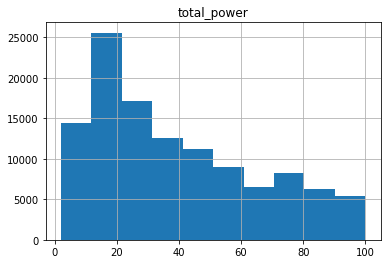

In [140]:
data[(data["total_power"] < 100)].hist(column="total_power")


# Middle power 100< < 1000 : 30% dataset

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1a4ffdaba8>]],
      dtype=object)

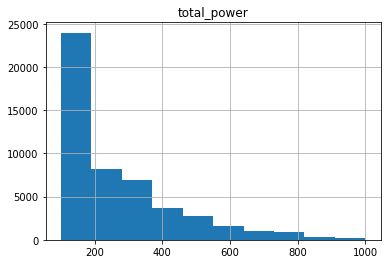

In [141]:
data[ (1000>data["total_power"]) &(data["total_power"]>=100) ].hist(column="total_power")


# High power > 1000 : 1,6% dataset

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1a559b1780>]],
      dtype=object)

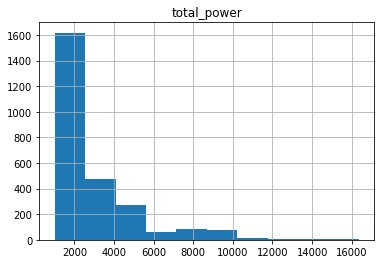

In [142]:
data[(data["total_power"] >= 1000)].hist(column="total_power")


In [91]:
print(__doc__)

# Author: Phil Roth <mr.phil.roth@gmail.com>
# License: BSD 3 clause


plt.figure(figsize=(12, 12))

n_samples = 1500
random_state = 170


# Incorrect number of clusters
y_pred = KMeans(n_clusters=3, random_state=random_state).fit_predict(X_train_hw_param)


Automatically created module for IPython interactive environment


<Figure size 864x864 with 0 Axes>

([<matplotlib.axis.XTick at 0x1a55965588>,
 <a list of 6 Text xticklabel objects>)

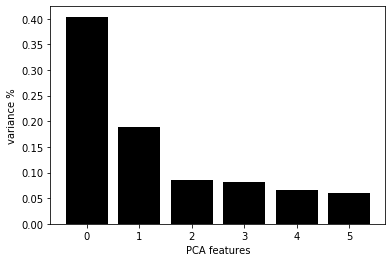

In [147]:
pca = PCA(n_components=6).fit(scale(data))
principalComponents = pca.fit_transform(scale(data))
PCA_components = pd.DataFrame(principalComponents)

features = range(pca.n_components_)
plt.bar(features, pca.explained_variance_ratio_, color='black')
plt.xlabel('PCA features')
plt.ylabel('variance %')
plt.xticks(features)



Text(0, 0.5, 'PCA 2')

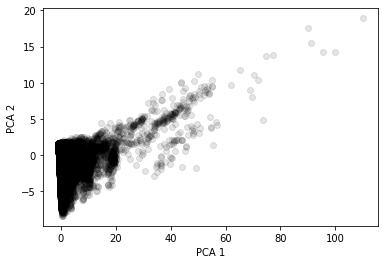

In [148]:
plt.scatter(PCA_components[0], PCA_components[1], alpha=.1, color='black')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')


In [113]:
pca = PCA(n_components=3).fit(scale(X_train_hw_param))
bench_k_means(KMeans(init=pca.components_, n_clusters=3, n_init=1),
              name="PCA-based",
              data=scale(X_train_hw_param))

PCA-based	0.16s	547373	0.074	0.990	0.138	0.000	0.012	0.323


In [115]:
pca

PCA(copy=True, iterated_power='auto', n_components=3, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

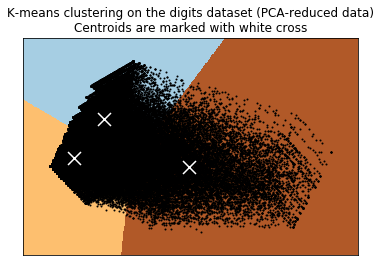

In [117]:
data = scale(X_train_hw_param)
n_digits = 3
reduced_data = PCA(n_components=2).fit_transform(data)
kmeans = KMeans(init='k-means++', n_clusters=n_digits, n_init=10)
kmeans.fit(reduced_data)

# Step size of the mesh. Decrease to increase the quality of the VQ.
h = .02     # point in the mesh [x_min, x_max]x[y_min, y_max].

# Plot the decision boundary. For that, we will assign a color to each
x_min, x_max = reduced_data[:, 0].min() - 1, reduced_data[:, 0].max() + 1
y_min, y_max = reduced_data[:, 1].min() - 1, reduced_data[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

# Obtain labels for each point in mesh. Use last trained model.
Z = kmeans.predict(np.c_[xx.ravel(), yy.ravel()])

# Put the result into a color plot
Z = Z.reshape(xx.shape)
plt.figure(1)
plt.clf()
plt.imshow(Z, interpolation='nearest',
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           cmap=plt.cm.Paired,
           aspect='auto', origin='lower')

plt.plot(reduced_data[:, 0], reduced_data[:, 1], 'k.', markersize=2)
# Plot the centroids as a white X
centroids = kmeans.cluster_centers_
plt.scatter(centroids[:, 0], centroids[:, 1],
            marker='x', s=169, linewidths=3,
            color='w', zorder=10)
plt.title('K-means clustering on the digits dataset (PCA-reduced data)\n'
          'Centroids are marked with white cross')
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.xticks(())
plt.yticks(())
plt.show()